In [1]:
DATA_DIR = '/lustre/groups/ml01/workspace/louis.kuemmerle/projects/A1/data2/'
DATA_DIR = '/Volumes/TOSHIBA_EXT/Promotion/data/A1/data2/'
RESULTS_DIR = '/lustre/groups/ml01/workspace/louis.kuemmerle/projects/A1/results/'
RESULTS_DIR = '/Volumes/TOSHIBA_EXT/Promotion/data/A1/results/'
DATA_VERSION = 'march22'


In [2]:
import os 
from pathlib import Path
import numpy as np
import scipy as sci
import pandas as pd
import seaborn as sb
import matplotlib.pyplot as pl

import scanpy as sc
import anndata as ann

from scipy.sparse import csr_matrix
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors


sc.settings.verbosity = 3
sc.logging.print_versions()

-----
anndata     0.8.0
scanpy      1.9.1
-----
PIL                 8.3.2
appnope             0.1.3
asttokens           NA
backcall            0.2.0
beta_ufunc          NA
binom_ufunc         NA
cffi                1.15.1
colorama            0.4.6
cycler              0.10.0
cython_runtime      NA
dateutil            2.8.2
debugpy             1.6.3
decorator           5.1.1
defusedxml          0.7.1
entrypoints         0.4
executing           1.2.0
h5py                3.7.0
hypergeom_ufunc     NA
igraph              0.9.11
ipykernel           6.17.1
ipython_genutils    0.2.0
ipywidgets          8.0.6
jedi                0.18.1
joblib              1.2.0
jupyter_server      1.23.2
kiwisolver          1.4.4
leidenalg           0.8.10
llvmlite            0.36.0
matplotlib          3.5.3
mpl_toolkits        NA
natsort             8.2.0
nbinom_ufunc        NA
ncf_ufunc           NA
numba               0.53.1
numpy               1.20.3
packaging           21.3
pandas              1.5.1
parso  

In [3]:
sc.settings.set_figure_params(dpi=70)
sc.settings.verbosity = 3
sc.settings.n_jobs = 3
sc.set_figure_params(vector_friendly=True,color_map='viridis',dpi_save=600,transparent=True)

# Introduction

In this notebook, we annotate human skull data. 

We perform the following steps:
1. Load the data
2. Visualise
3. (Check for Batch Effects and correct, if necessary - situation on 3.3.22: we only have 1 batch)
4. Visualise again, cluster, get characteristics

# Load data

In [4]:
adata = sc.read(DATA_DIR+f'human_data_norm_{DATA_VERSION}.h5ad')

In [5]:
adata

AnnData object with n_obs × n_vars = 4527 × 21044
    obs: 'region', 'organism', 'sample', 'condition', 'n_counts', 'log_counts', 'n_genes', 'mt_fraction', 'size_factors'
    var: 'ensemble_id', 'n_cells'
    uns: 'sample_colors'

Check the contributions per sample.

Remove mitochondrial reads.

In [6]:
mt_gene_mask = [gene.startswith('MT-') for gene in adata.var_names]
mt_gene_index = np.where(np.invert(mt_gene_mask))[0]
adata=adata[:, mt_gene_index]

/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


# Highly variable genes

In [7]:
#sc.pp.highly_variable_genes(adata, batch_key='sample_name', flavor='cell_ranger', n_top_genes=4000)
sc.pp.highly_variable_genes(adata, flavor='cell_ranger', n_top_genes=4000)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)


Trying to set attribute `.uns` of view, copying.


--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


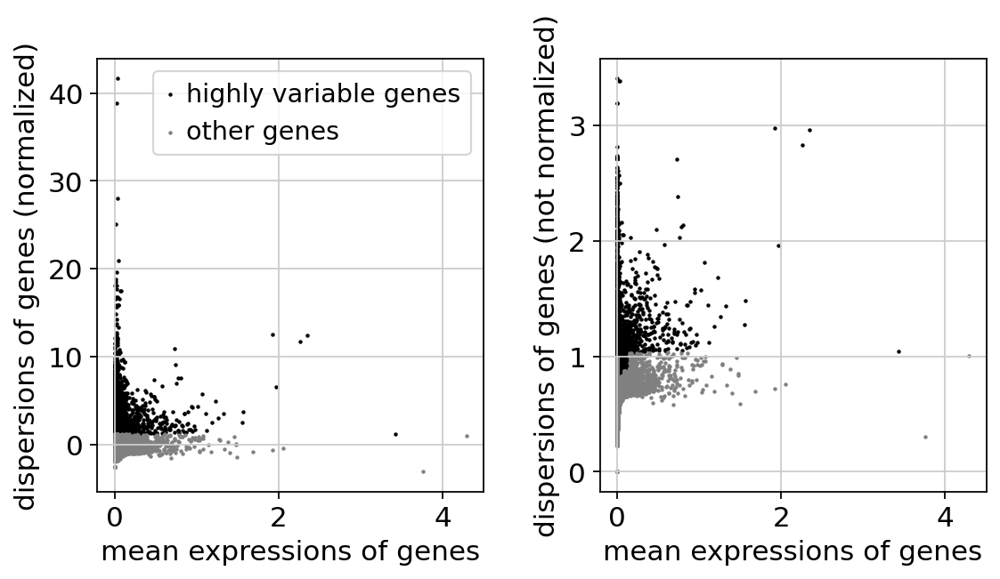

In [8]:
sc.pl.highly_variable_genes(adata)

# First visualisation

computing PCA
    on highly variable genes
    with n_comps=50


/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


    finished (0:00:01)


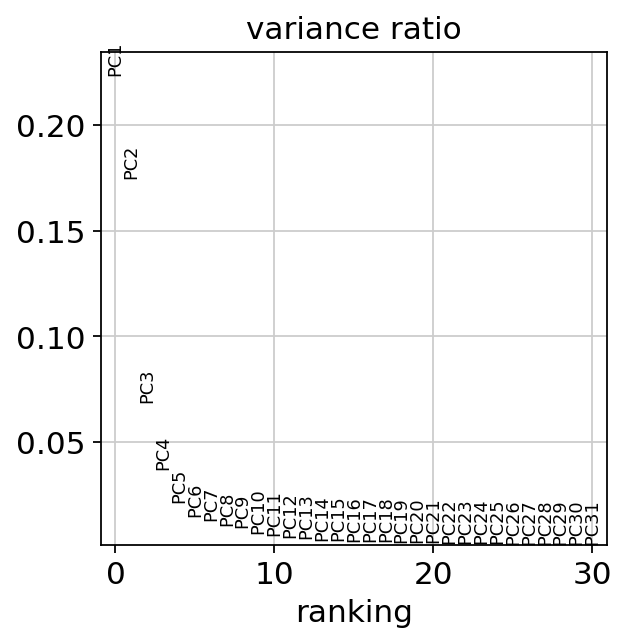

In [9]:
a = adata.copy()
sc.tl.pca(a)
sc.pl.pca_variance_ratio(a)

In [10]:
sc.tl.pca(adata, svd_solver='arpack', n_comps=14)
sc.pp.neighbors(adata)
sc.tl.leiden(adata, resolution=0.5)
sc.tl.umap(adata)

computing PCA
    on highly variable genes
    with n_comps=14


/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 14
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
running Leiden clustering
    finished: found 12 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:08)


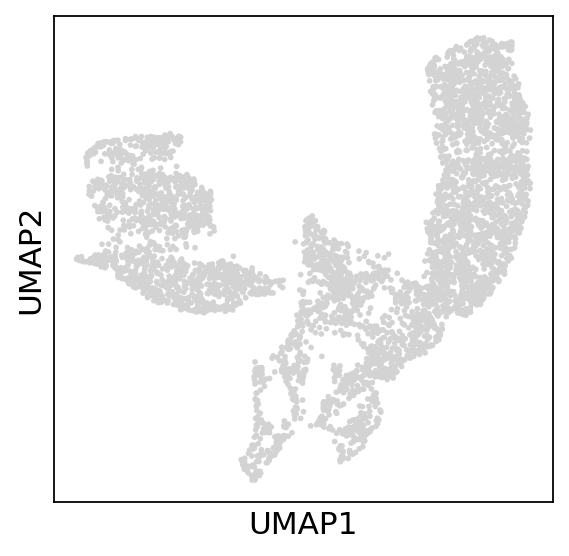

In [11]:
sc.pl.umap(adata)

In [12]:
sc.tl.leiden(adata, resolution = 2, key_added='leiden_high_res')

running Leiden clustering
    finished: found 33 clusters and added
    'leiden_high_res', the cluster labels (adata.obs, categorical) (0:00:00)


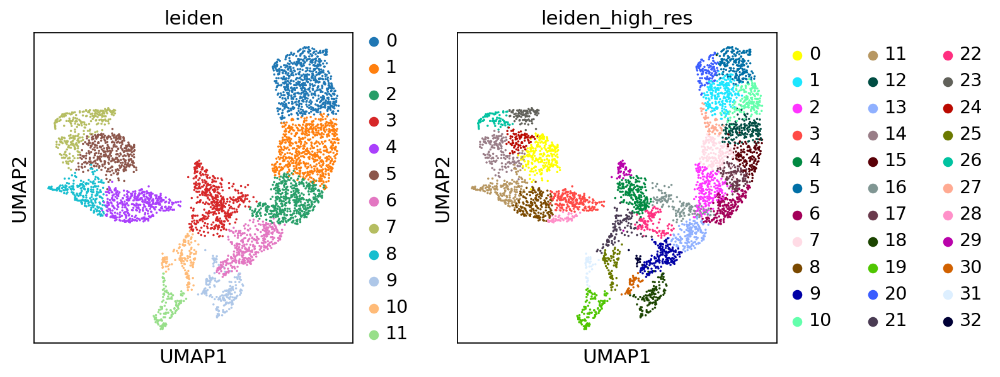

In [13]:
sc.pl.umap(adata, color=['leiden','leiden_high_res'],ncols=2,size=10)

Plan:
1. annotate neutrophils and erthroid cells
2. subset the data, annotate next clusters --> monocytes, DC, b cells, nkt, progenitors

### Annotation step 1: neutrophils and erythroid cells

In [14]:
markers = {
    'pro neutrophil'      : ["MKI67", "TOP2A", "CEBPE"],
    'pre neutrophil'      : ['PTMA', 'RPL3'],
    'immature neutrophil' : ['LTF'],
    'mature neutrophil'   : ['CXCR2'],
    "neutrophils"         : ['S100A9', 'S100A8'],
    "Proerythroblast" : ["SYNGR1","CDK6"],
    "Erythroblast" : ["MKI67","HBM",'PRDX2'],
    "Normoblast" : ["SLC4A1","SLC25A37"],    
    'erythroid cell': ['HMBS', 'DENND4A', 'HBA2', 'HBA1', 'HBB'],
}


/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


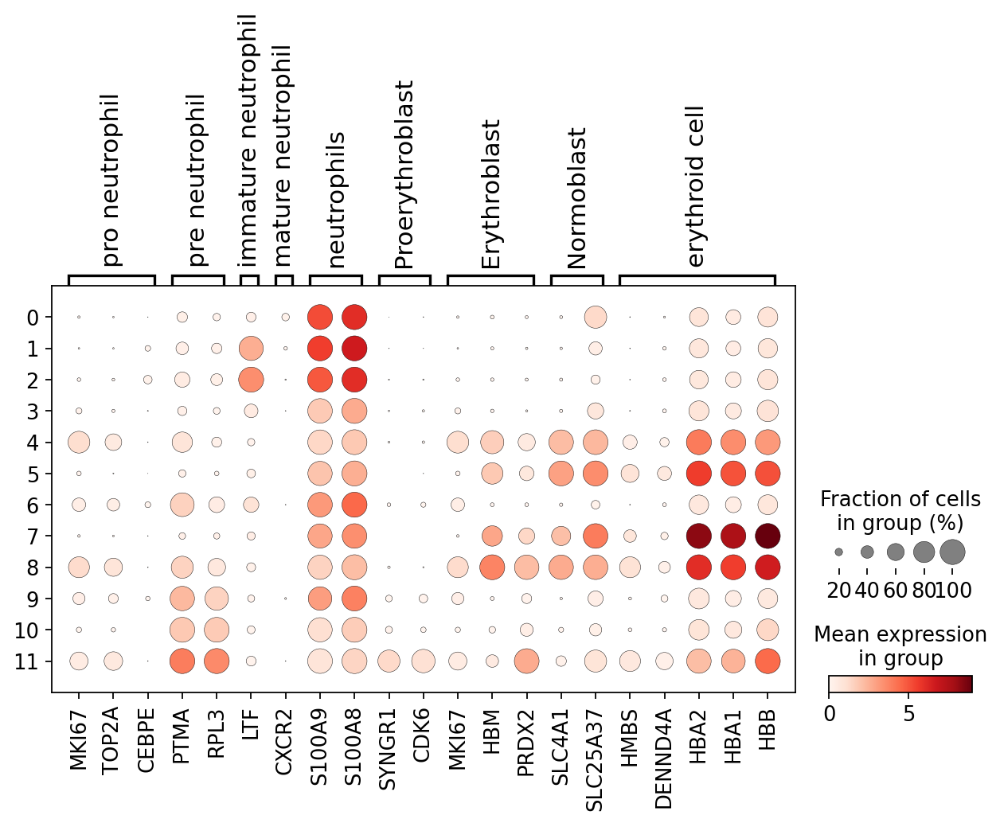

In [15]:
sc.pl.dotplot(adata,markers,"leiden")

In [16]:
ct_to_leiden = {
    "neutrophil" : ["0","1","2"],
    "erythroid cell" : ["4","5","7","8"],
}
leiden_to_ct = {l:ct for ct,ls in ct_to_leiden.items() for l in ls}


In [17]:
adata.obs["celltype_1"] = adata.obs["leiden"].apply(lambda l: leiden_to_ct[l] if l in leiden_to_ct else "other")

... storing 'celltype_1' as categorical


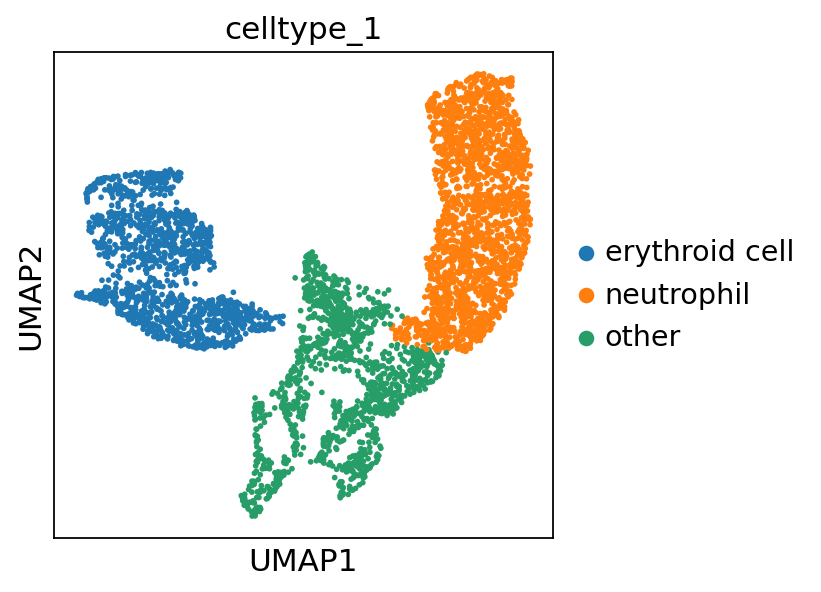

In [18]:
sc.pl.umap(adata,color="celltype_1")

In [19]:
adata2 = adata[adata.obs["celltype_1"] == "other"].copy()

/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)


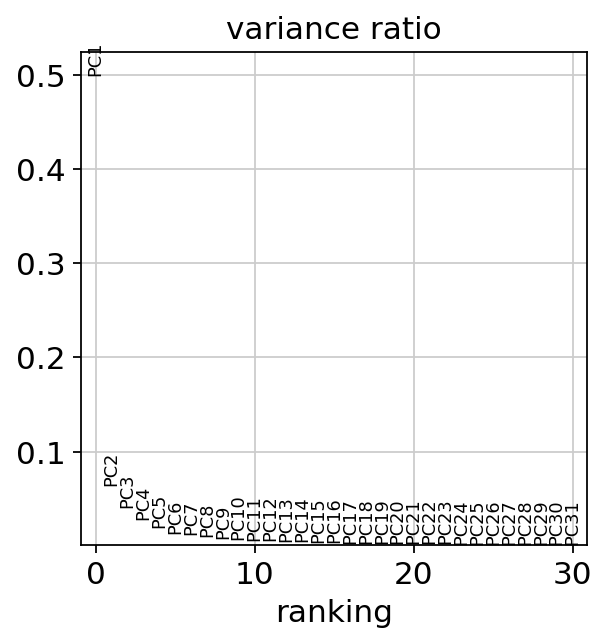

In [20]:
a = adata2.copy()
sc.tl.pca(a)
sc.pl.pca_variance_ratio(a)

In [21]:
sc.tl.pca(adata2,n_comps=14)
sc.pp.neighbors(adata2)
sc.tl.umap(adata2)

computing PCA
    on highly variable genes
    with n_comps=14


/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 14
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:02)


In [22]:
sc.tl.leiden(adata2,resolution=2)

running Leiden clustering
    finished: found 24 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


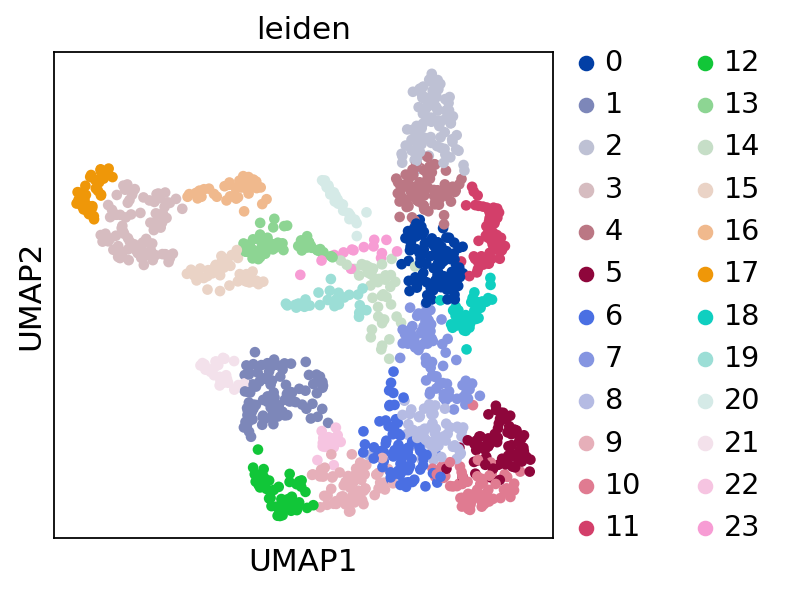

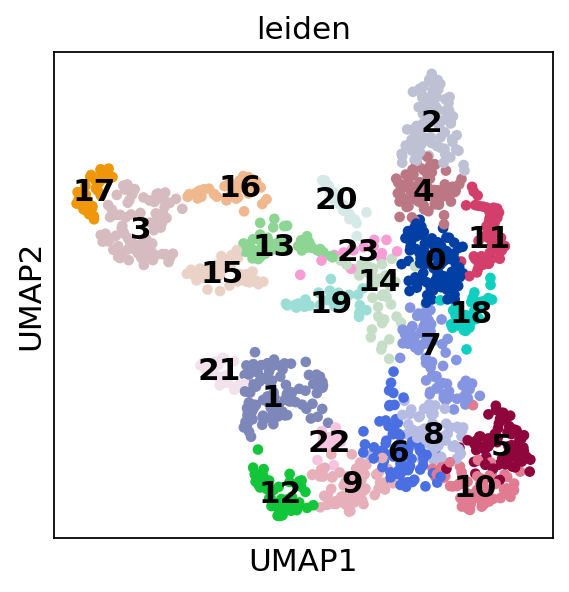

In [23]:
sc.pl.umap(adata2,color="leiden")
sc.pl.umap(adata2,color="leiden",legend_loc="on data")

##### Save adatas

In [31]:
sc.write(Path(DATA_DIR,"human_sc",f"adata_{DATA_VERSION}_leiden.h5ad"),adata)
sc.write(Path(DATA_DIR,"human_sc",f"adata_{DATA_VERSION}_leiden_subset.h5ad"),adata2)

### Continue with finer annotations

In [4]:
adata = sc.read(Path(DATA_DIR,"human_sc",f"adata_{DATA_VERSION}_leiden.h5ad"))
adata2 = sc.read(Path(DATA_DIR,"human_sc",f"adata_{DATA_VERSION}_leiden_subset.h5ad"))

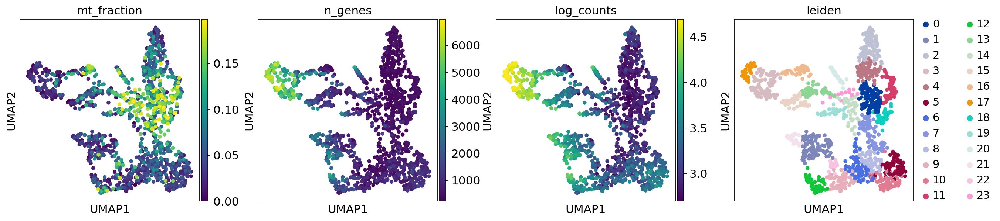

In [5]:
sc.pl.umap(adata2, color=["mt_fraction","n_genes","log_counts","leiden"])

monocyte


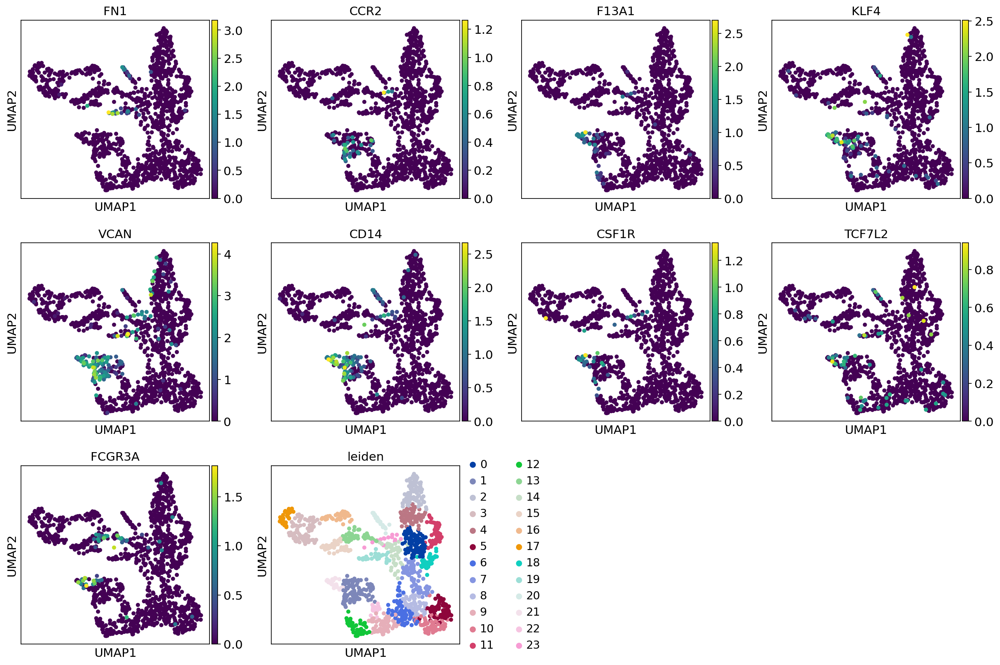

macrophage


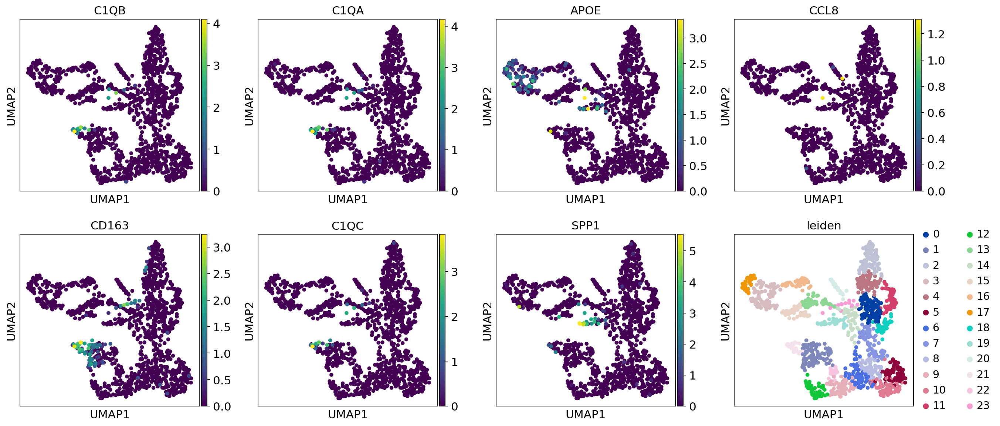

B cell


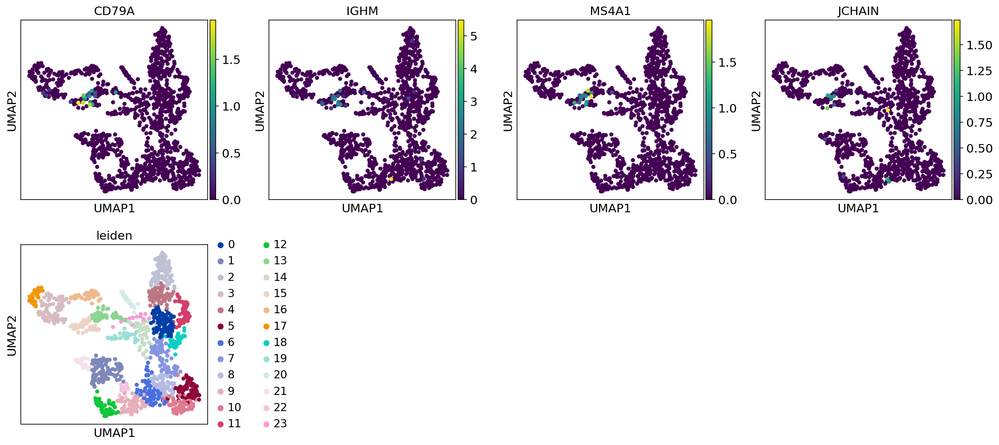

T cell


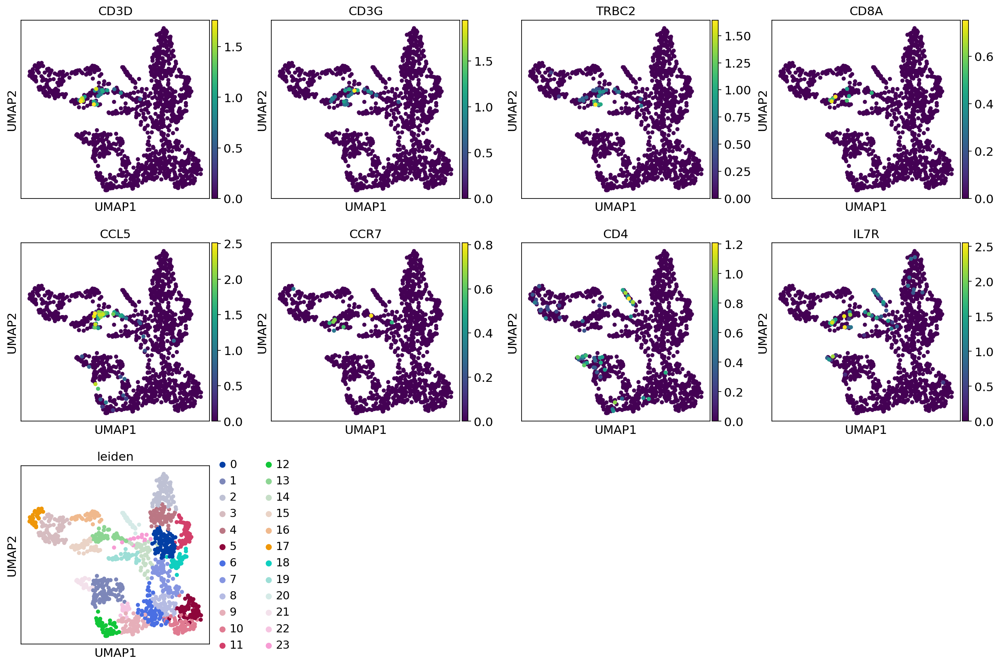

NK


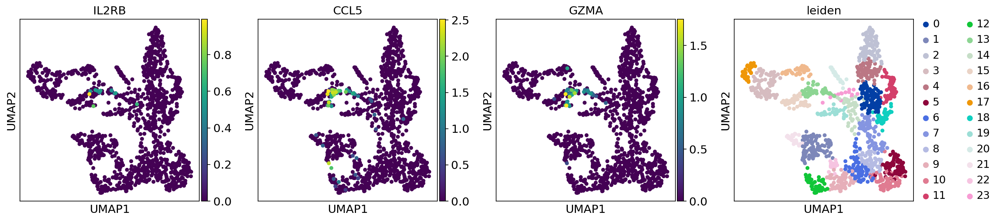

DC


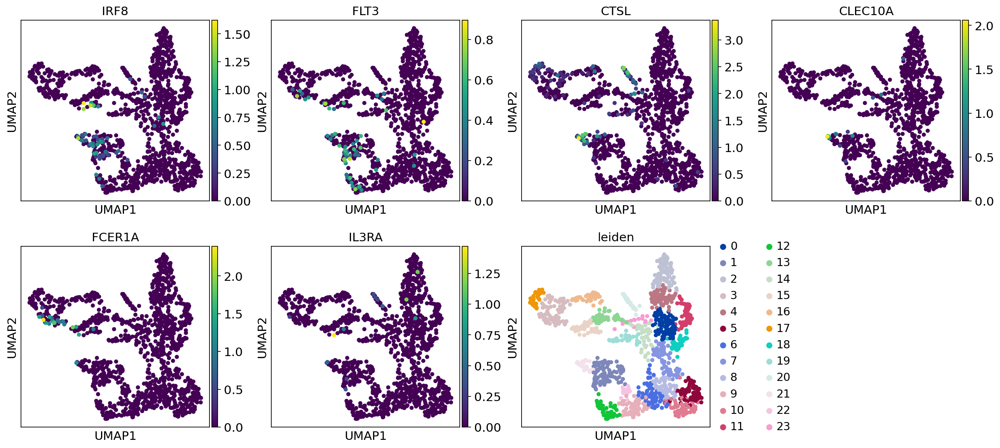

HSC or other


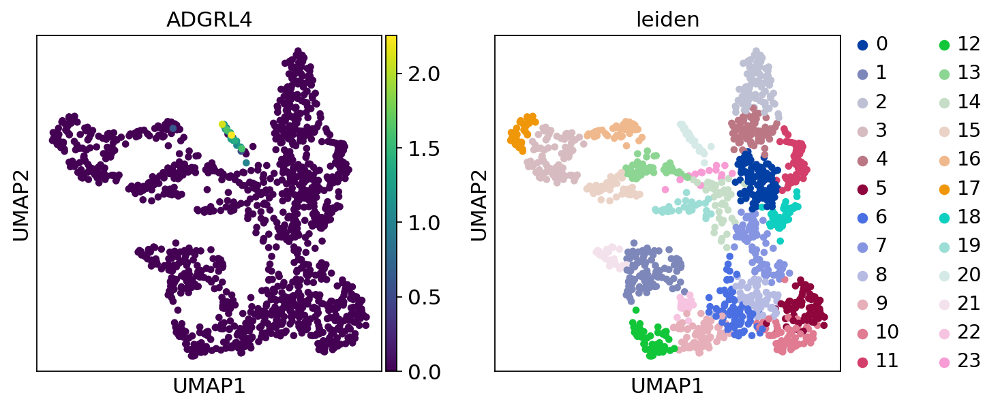

other


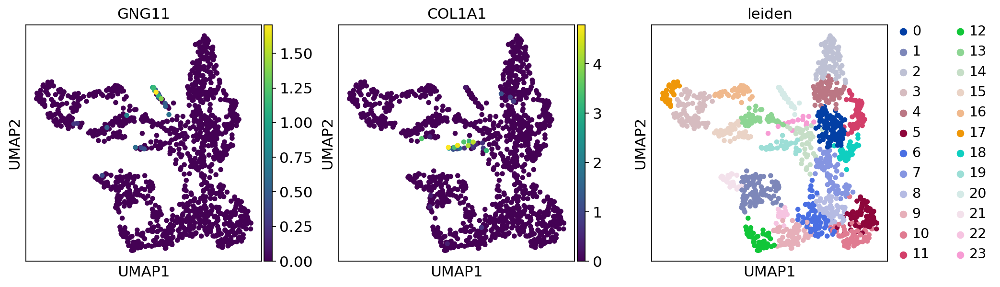

endothelial


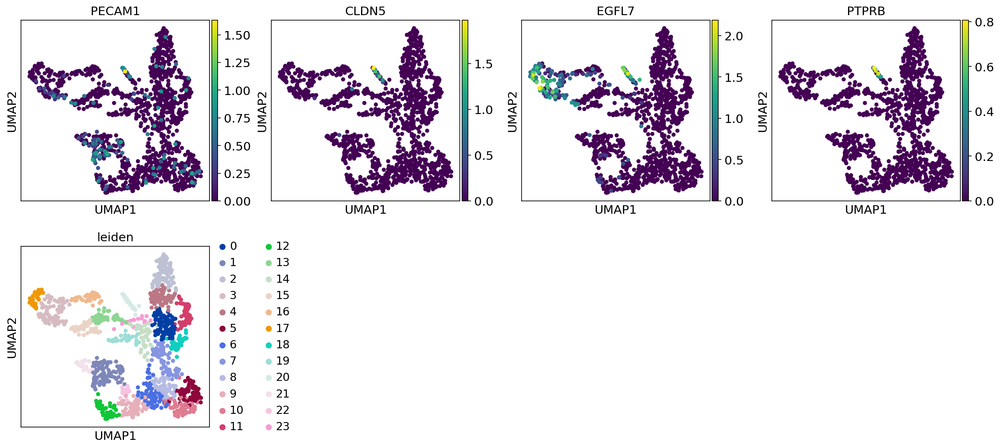

In [36]:
specific_genes = {
    "monocyte" : ["FN1","CCR2","F13A1", "KLF4","VCAN","CD14","CSF1R","TCF7L2","FCGR3A"],
    "macrophage" : ["C1QB", "C1QA", "APOE", "CCL8", "CD163", "C1QC","SPP1"],
    "B cell" : ["CD79A","IGHM","MS4A1","JCHAIN"],
    "T cell" : ["CD3D","CD3G","TRBC2","CD8A","CCL5","CCR7","CD4","IL7R"],
    "NK" : ["IL2RB","CCL5","GZMA"],
    "DC" : ["IRF8","FLT3","CTSL","CLEC10A","FCER1A","IL3RA"],
    "HSC or other" : ["ADGRL4"],
    "other" : ["GNG11","COL1A1"],
    "endothelial" : ["PECAM1","CLDN5","EGFL7","PTPRB"],
}
for ct, gene_list in specific_genes.items():
    print(ct)
    sc.pl.umap(adata2, color=gene_list+["leiden"])

##### dotplot with DE genes

In [6]:
def get_filtered_genes(adata, frac_of_cells=0.3, max_clusters=0.4):
    """
    """
    
    n_clusters = len(adata.obs["leiden"].unique())
    
    df = pd.DataFrame(
        index= adata.obs_names,
        columns=adata.var_names,
        data = adata.X > 0,
    )
    df["leiden"] = adata.obs["leiden"]
    
    df = df.groupby("leiden").mean()
    
    df = df > frac_of_cells
    
    gene_mask = (df.sum(axis=0) < (n_clusters * max_clusters)).values
    
    return df.columns[gene_mask].tolist()
    
    

In [45]:
tests = {
    "ILC?" : [2,4],
    "high MT" : [0,7,11,14,18],
    "neutroish?" : [5,6,8,10],
    "structural20?" : [20],
    "structural19?" : [19],
    "in between" : [23],
    "monocyte" : [1,21],
    "B T NK DC" : [13,15],
    "progenitors" : [3,16,17],
    "GMP" : [12,9,22],
}

a_tmp = adata2[:,get_filtered_genes(adata2, frac_of_cells=0.3, max_clusters=0.4)].copy()
genes = {}
for name, cluster in tests.items():
    a_tmp.obs[name] = a_tmp.obs["leiden"].isin([str(l) for l in cluster]).astype(str)
    sc.tl.rank_genes_groups(a_tmp,name)
    df = sc.get.rank_genes_groups_df(a_tmp,"True")
    df = df.loc[~df["names"].apply(lambda s: s.startswith("RPL") or s.startswith("RPS"))]
    
    genes[f"{name} up"] = df["names"].iloc[:15].tolist()
    #genes[f"{name} down"] = df["names"].iloc[-10:].tolist()

ranking genes


/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
... storing 'ILC?' as categorical


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
ranking genes


... storing 'high MT' as categorical


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
ranking genes


... storing 'neutroish?' as categorical


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
ranking genes


... storing 'structural20?' as categorical


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
ranking genes


... storing 'structural19?' as categorical


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
ranking genes


... storing 'in between' as categorical


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
ranking genes


... storing 'monocyte' as categorical


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
ranking genes


... storing 'B T NK DC' as categorical


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
ranking genes


... storing 'progenitors' as categorical


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
ranking genes


... storing 'GMP' as categorical


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


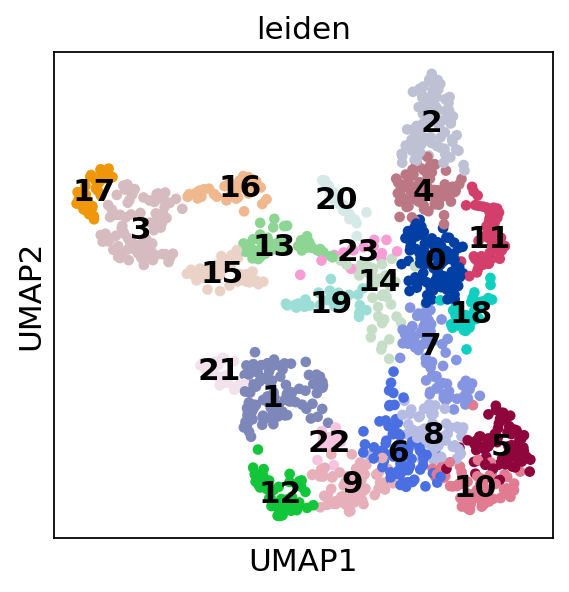

In [48]:
sc.pl.umap(adata2,color="leiden",legend_loc="on data")

In [46]:
cluster_order = [str(c) for _,cs in tests.items() for c in cs]
a_tmp = adata2.copy()
a_tmp.obs["leiden"] = a_tmp.obs["leiden"].cat.reorder_categories(cluster_order)

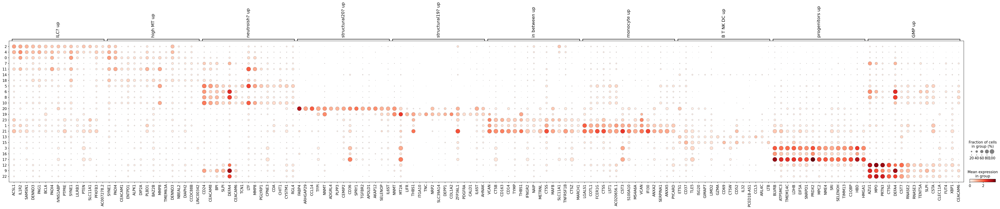

In [47]:
sc.pl.dotplot(a_tmp,genes,"leiden")#,dendrogram=True)

/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


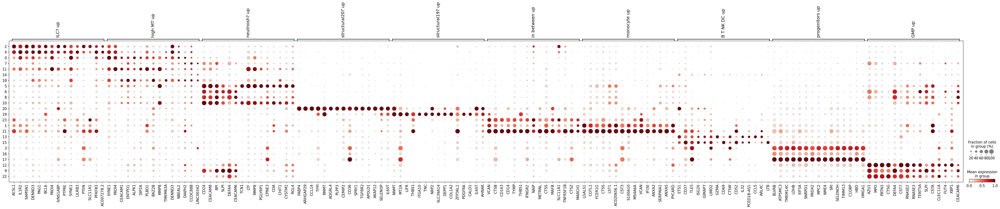

In [48]:
sc.pl.dotplot(a_tmp,genes,"leiden",standard_scale="var") # ,dendrogram=True

In [17]:
tests = {
    "structural? 20" : [20],
    "structural? 19" : [19],    
    "ILC? 2_4" : [2,4],
    "high MT 0_11_18" : [0,11,18],
    "high MT 7_14" : [7,14],
    #"neutroish?" : [5,6,8,10],

    #"in between" : [23],
    #"monocyte" : [1,21],
    #"B T NK DC" : [13,15],
    #"progenitors" : [3,16,17],
    #"GMP" : [12,9,22],
}

a_tmp = adata2[:,get_filtered_genes(adata2, frac_of_cells=0.3, max_clusters=0.4)].copy()
genes = {}
for name, cluster in tests.items():
    a_tmp.obs[name] = a_tmp.obs["leiden"].isin([str(l) for l in cluster]).astype(str)
    sc.tl.rank_genes_groups(a_tmp,name)
    df = sc.get.rank_genes_groups_df(a_tmp,"True")
    df = df.loc[~df["names"].apply(lambda s: s.startswith("RPL") or s.startswith("RPS"))]
    
    genes[f"{name} up"] = df["names"].iloc[:35].tolist()
    #genes[f"{name} down"] = df["names"].iloc[-10:].tolist()

/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


ranking genes


... storing 'structural? 20' as categorical


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
ranking genes


... storing 'structural? 19' as categorical


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
ranking genes


... storing 'ILC? 2_4' as categorical


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
ranking genes


... storing 'high MT 0_11_18' as categorical


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
ranking genes


... storing 'high MT 7_14' as categorical


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


In [18]:
cluster_order = [str(c) for _,cs in tests.items() for c in cs]
cluster_order+= [c for c in adata2.obs["leiden"].cat.categories if c not in cluster_order]

a_tmp = adata2.copy()
a_tmp.obs["leiden"] = a_tmp.obs["leiden"].cat.reorder_categories(cluster_order)

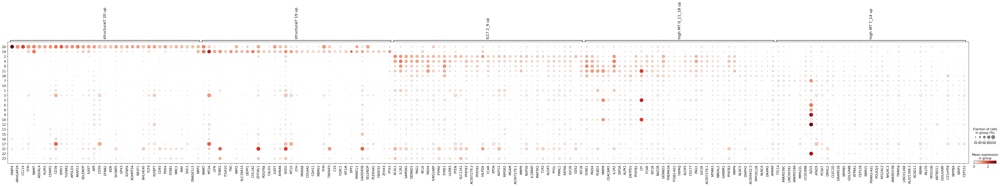

In [19]:
sc.pl.dotplot(a_tmp,genes,"leiden")#,dendrogram=True)

/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


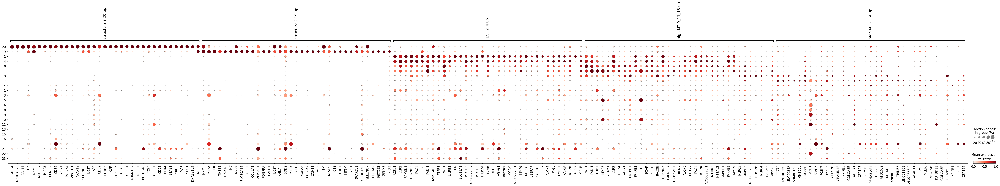

In [20]:
sc.pl.dotplot(a_tmp,genes,"leiden",standard_scale="var") # ,dendrogram=True

In [26]:
for ct, gs in genes.items():
    print("### ",ct)
    print(", ".join(gs))
    print("\n")

###  structural? 20 up
FABP4, ARHGAP29, CCL14, TFPI, NNMT, ADGRL4, PLPP3, CEMIP2, CD36, SPRY1, TGFBR2, APOLD1, AKAP12, SELENOP, IL6ST, APP, CD59, EFNB2, KDR, SH3BP5, GPX3, IGFBP4, ADAMTS4, NR2F1, BHLHE40, TCF4, IGFBP7, CD93, PDK4, STAB1, MRC1, MAF, SHC1, DNASE1L3, NRP2


###  structural? 19 up
NNMT, MT2A, LIFR, THBS1, ITGA10, TNC, NRP2, SLC39A14, DEPP1, COL1A2, ZFP36L1, PDGFRA, CALD1, IL6ST, AHNAK, SOD2, MT1X, CFH, MXRA8, COL6A2, CDH11, RBMS3, TFPI, TNFAIP3, C1S, FOXC1, MT1M, SPP1, SPARCL1, GADD45B, SELENOP, PLEKHA5, FBXO32, ZFHX3, PTX3


###  ILC? 2_4 up
ACSL1, IL1R2, SAMSN1, DENND3, PAG1, BCL6, PADI4, IVNS1ABP, PTPRE, SYNE1, LILRB3, PTEN, SLC11A1, PFKFB3, AC007278.2, PFKFB2, HILPDA, FCAR, XPO6, AGFG1, RIPOR2, MGAM, AC007278.1, MMP9, NUP58, IL18RAP, MAP3K2, TLR2, ALOX5, PYGL, FMNL1, KAT6A, IGF2R, G0S2, KIF1B


###  high MT 0_11_18 up
SYNE1, PADI4, PLBD1, MMP8, CEACAM1, IL1R2, DIP2A, ALPK1, ENTPD1, PFKFB2, LTF, FCAR, KIF1B, BAZ2B, DENND3, TMEM63A, ITGB2-AS1, TRPM2, ALOX5, CD177, PAG1, 

# Final annotations

In [11]:
adata

AnnData object with n_obs × n_vars = 4527 × 21031
    obs: 'region', 'organism', 'sample', 'condition', 'n_counts', 'log_counts', 'n_genes', 'mt_fraction', 'size_factors', 'leiden', 'leiden_high_res', 'celltype_1'
    var: 'ensemble_id', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'celltype_1_colors', 'hvg', 'leiden', 'leiden_colors', 'leiden_high_res_colors', 'neighbors', 'pca', 'sample_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [13]:
adata.obs["leiden_subset"] = adata.obs["celltype_1"].astype(str)
adata.obs.loc[adata2.obs_names,"leiden_subset"] = adata2.obs.loc[adata2.obs_names,"leiden"]

In [ ]:
'neutrophil'              : ["S100a9","S100a8"],
    'pro neutrophil'      : ["Mki67", "Top2a", "Cebpe"],
    'pre neutrophil'      : ["Ptma","Rpl3"],
    'immature neutrophil' : ["Ngp","Ltf"],
    'mature neutrophil'   : ["Ccl6", "Cxcr2"],

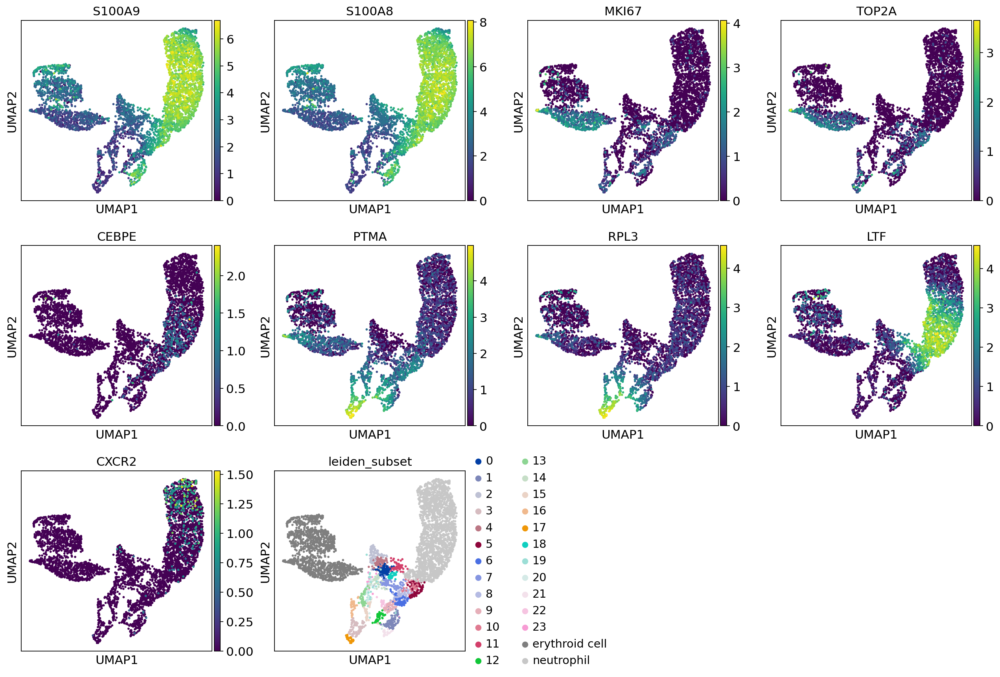

In [19]:
sc.pl.umap(adata,color=["S100A9","S100A8", "MKI67", "TOP2A", "CEBPE", "PTMA","RPL3","LTF", "CXCR2"]+["leiden_subset"])

... storing 'leiden_subset' as categorical


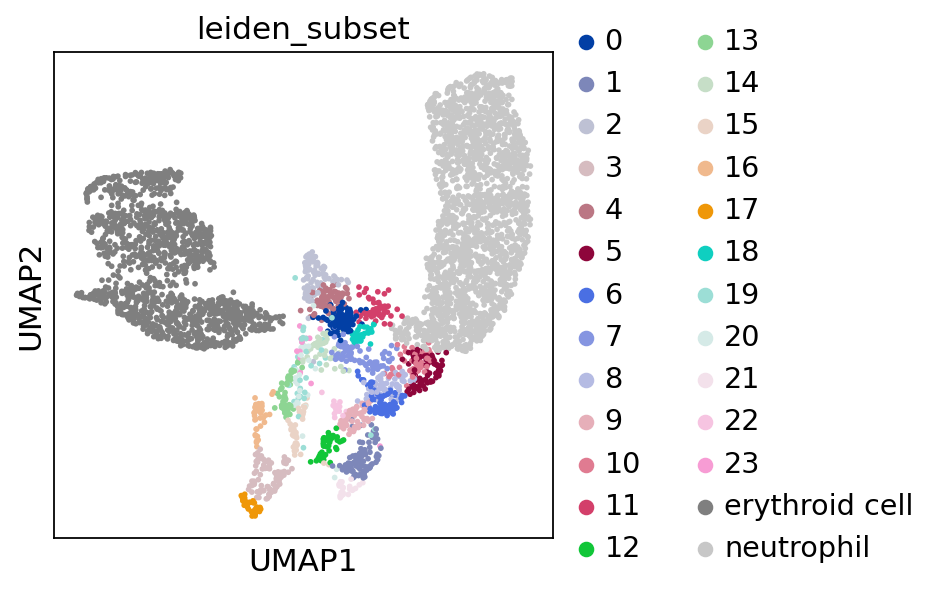

In [14]:
sc.pl.umap(adata,color=["leiden_subset"])

In [ ]:
# progenitor, GMP, monocyte, macrophage, EC, fibroblast, 
# split up NK, B, T, DC
# filter out high MTs
# what about ILCs??
# dotplot with annotations
# dotplot with proteomic markers

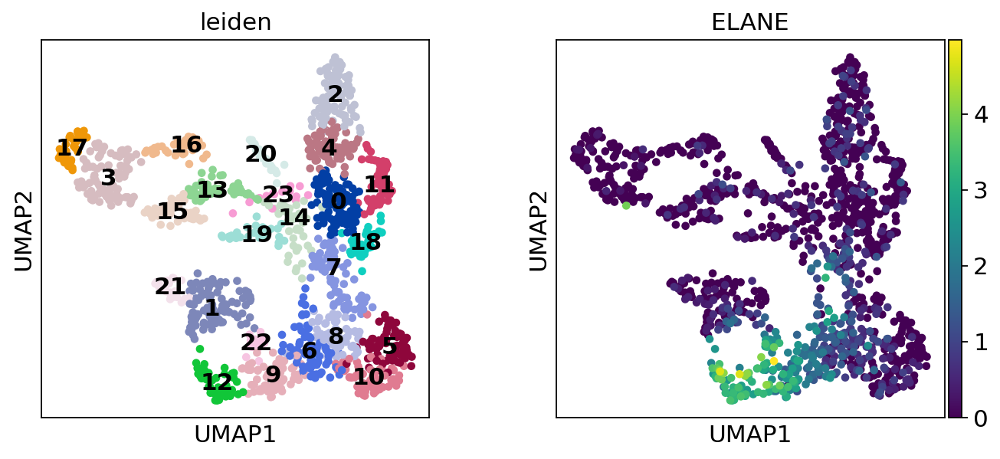

In [10]:
sc.pl.umap(adata2,color=["leiden","ELANE"],legend_loc="on data")

In [30]:
ct_to_leiden = {
    "progenitor" : [3,16,17],
    "B T NK DC"  : [13,15],
    "GMP"        : [9,12,22],
    "monocyte"   : [1],
    "macrophage" : [21],
    "neutrophil" : [5,6,8,10],
    "eosinophil" : [2,4],
    "fibroblast" : [19],
    "EC"         : [20],
    "filter_out" : [7,14,0,11,18, 23],
}

leiden_to_ct = {str(l):ct for ct,ls in ct_to_leiden.items() for l in ls}

adata2.obs["celltype_2"] = adata2.obs["leiden"].apply(lambda l:leiden_to_ct[l])

... storing 'celltype_2' as categorical


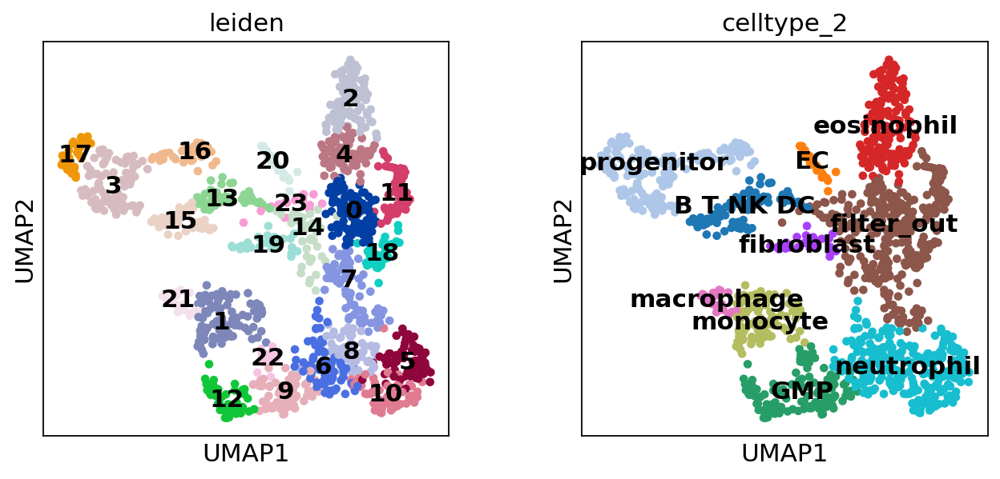

In [31]:
sc.pl.umap(adata2,color=["leiden","celltype_2"],legend_loc="on data")

In [32]:
adata3 = adata2[adata2.obs["celltype_2"]=="B T NK DC"].copy()

/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)


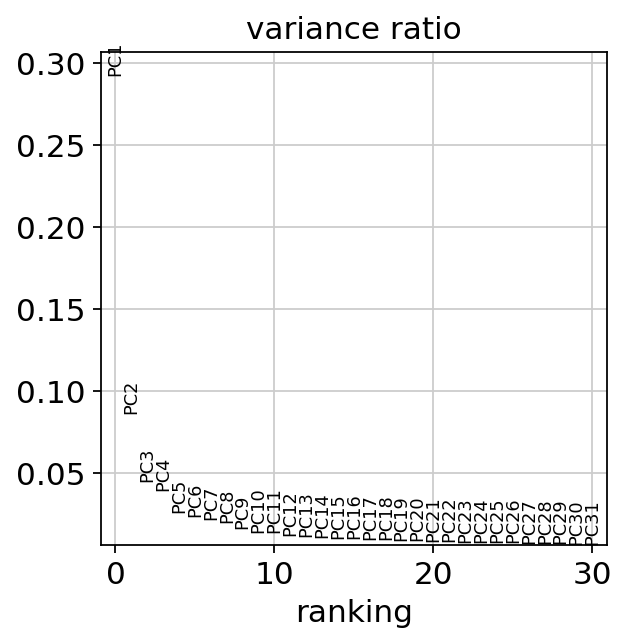

In [33]:
a_tmp = adata3.copy()
sc.tl.pca(a_tmp)
sc.pl.pca_variance_ratio(a_tmp)

In [34]:
sc.tl.pca(adata3,n_comps=20)
sc.pp.neighbors(adata3)
sc.tl.umap(adata3)

computing PCA
    on highly variable genes
    with n_comps=20
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 20


/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


In [38]:
sc.tl.leiden(adata3)

running Leiden clustering
    finished: found 6 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


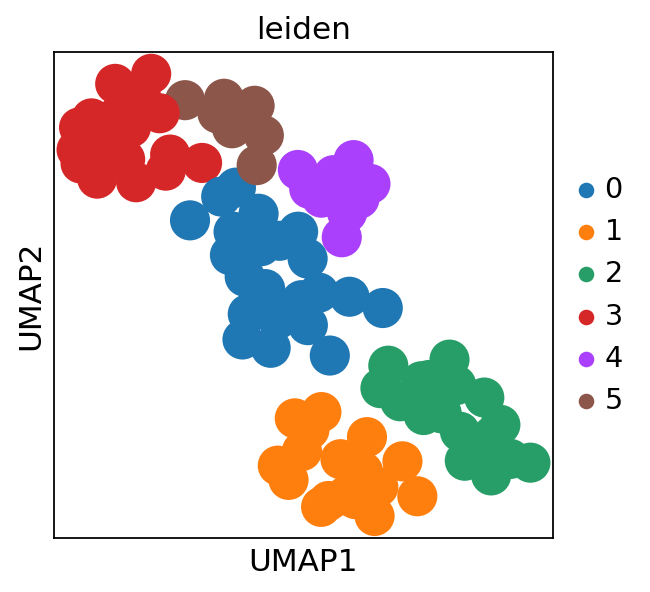

In [39]:
sc.pl.umap(adata3,color="leiden")

###  B cell  ###


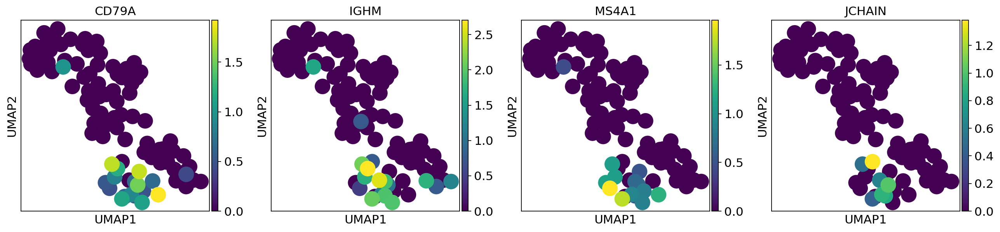

###  T cell  ###


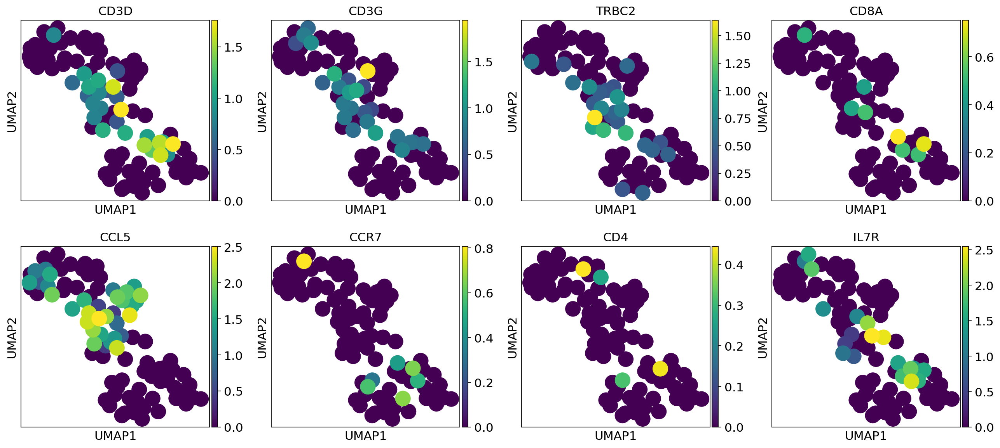

###  NK  ###


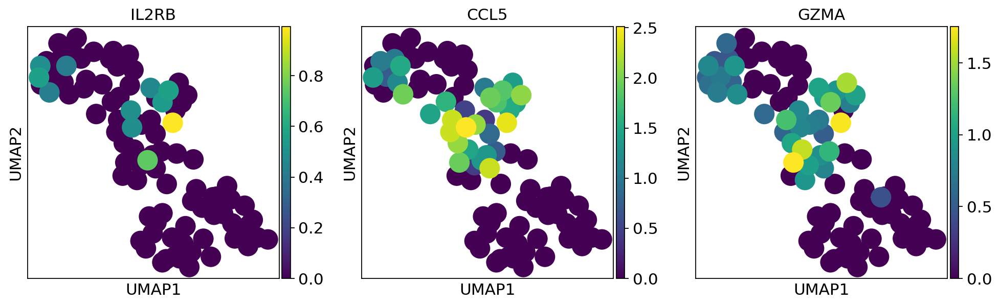

###  DC  ###


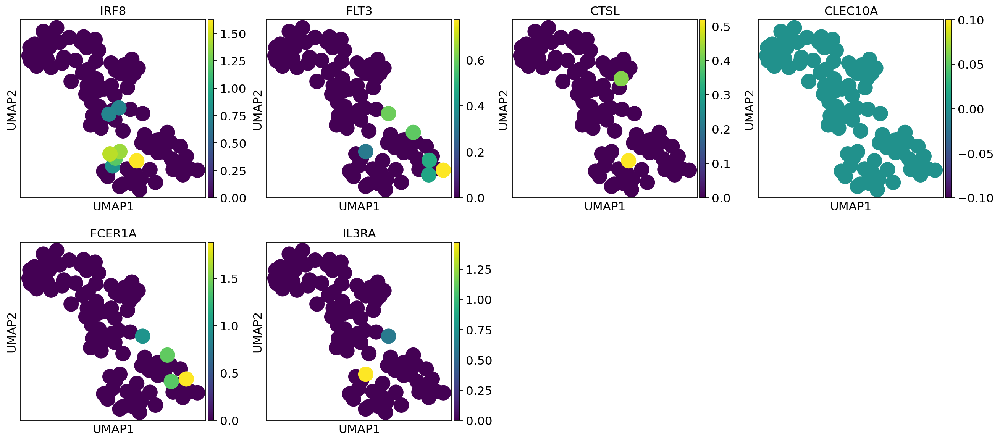

In [37]:
markers = {
    "B cell" : ["CD79A","IGHM","MS4A1","JCHAIN"],
    "T cell" : ["CD3D","CD3G","TRBC2","CD8A","CCL5","CCR7","CD4","IL7R"],
    "NK" : ["IL2RB","CCL5","GZMA"],
    "DC" : ["IRF8","FLT3","CTSL","CLEC10A","FCER1A","IL3RA"],
}
for ct, gs in markers.items():
    print("### ", ct, " ###")
    sc.pl.umap(adata3,color=gs)

In [42]:
def get_filtered_genes(adata, frac_of_cells=0.3, max_clusters=0.4):
    """
    """
    
    n_clusters = len(adata.obs["leiden"].unique())
    
    df = pd.DataFrame(
        index= adata.obs_names,
        columns=adata.var_names,
        data = adata.X > 0,
    )
    df["leiden"] = adata.obs["leiden"]
    
    df = df.groupby("leiden").mean()
    
    df = df > frac_of_cells
    
    gene_mask = (df.sum(axis=0) < (n_clusters * max_clusters)).values
    
    return df.columns[gene_mask].tolist()

ranking genes


/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.uns` of view, copying.


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


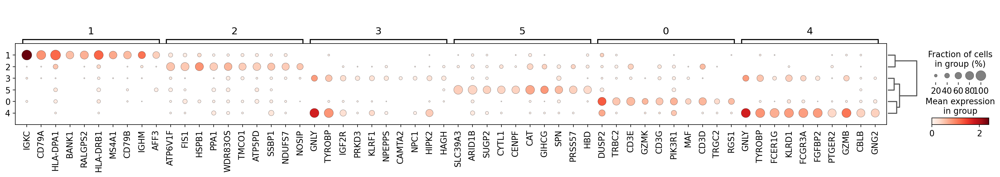

In [43]:
a_tmp = adata3[:,get_filtered_genes(adata3, frac_of_cells=0.3, max_clusters=0.4)]
sc.tl.rank_genes_groups(a_tmp, "leiden")
sc.pl.rank_genes_groups_dotplot(a_tmp)

In [45]:
ct_to_leiden = {
    "NK T cell" : [0, 2, 3, 4, 5], #2
    "B cell" : [1],
}

leiden_to_ct = {str(l):ct for ct,ls in ct_to_leiden.items() for l in ls}

adata3.obs["celltype_3"] = adata3.obs["leiden"].apply(lambda l:leiden_to_ct[l])

# ATP6V1F, FIS1, TMCO1 - NK T
# SUGP2 - NK T
# CYTL1 - T
# tyrobp - NK
# GNLY - NK (strong!)

In [50]:
sc.write(Path(DATA_DIR,"human_sc",f"adata_{DATA_VERSION}_leiden_subset_subset.h5ad"),adata3)

In [47]:
sc.tl.rank_genes_groups(adata3,"celltype_3")

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


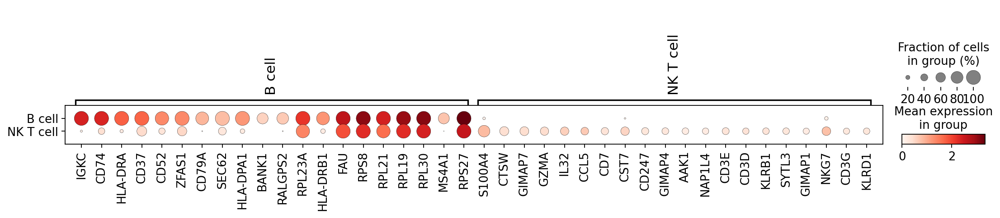

In [49]:
sc.pl.rank_genes_groups_dotplot(adata3,n_genes=20)

# Final adata and dotplot

In [47]:
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors

plt.rcParams['figure.dpi'] = 110
plt.rcParams['savefig.dpi'] = 150
SMALL_SIZE = 13
MEDIUM_SIZE = 15
BIGGER_SIZE = 17
plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title


In [4]:
adata = sc.read(Path(DATA_DIR,"human_sc",f"adata_{DATA_VERSION}_leiden.h5ad"))
adata2 = sc.read(Path(DATA_DIR,"human_sc",f"adata_{DATA_VERSION}_leiden_subset.h5ad"))
adata3 = sc.read(Path(DATA_DIR,"human_sc",f"adata_{DATA_VERSION}_leiden_subset_subset.h5ad"))

####################
# final cell types #
####################
# get coarse annotations
adata.obs["celltype"] = adata.obs["celltype_1"].astype(str)
# get fine annotations (wasn't saved in adata2 h5ad)
ct_to_leiden = {
    "progenitor" : [3,16,17],
    "B T NK DC"  : [13,15],
    "GMP"        : [9,12,22],
    "monocyte"   : [1],
    "macrophage" : [21],
    "neutrophil" : [5,6,8,10],
    "eosinophil" : [2,4],
    "fibroblast" : [19],
    "EC"         : [20],
    "filter_out" : [7,14,0,11,18, 23],
}
leiden_to_ct = {str(l):ct for ct,ls in ct_to_leiden.items() for l in ls}
adata2.obs["celltype_2"] = adata2.obs["leiden"].apply(lambda l:leiden_to_ct[l])
adata.obs.loc[adata2.obs_names,"celltype"] = adata2.obs.loc[adata2.obs_names,"celltype_2"]
# get fine annotations for B and NK T cells
adata.obs.loc[adata3.obs_names,"celltype"] = adata3.obs.loc[adata3.obs_names,"celltype_3"]

adata = adata[adata.obs["celltype"] != "filter_out"]

/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:01)


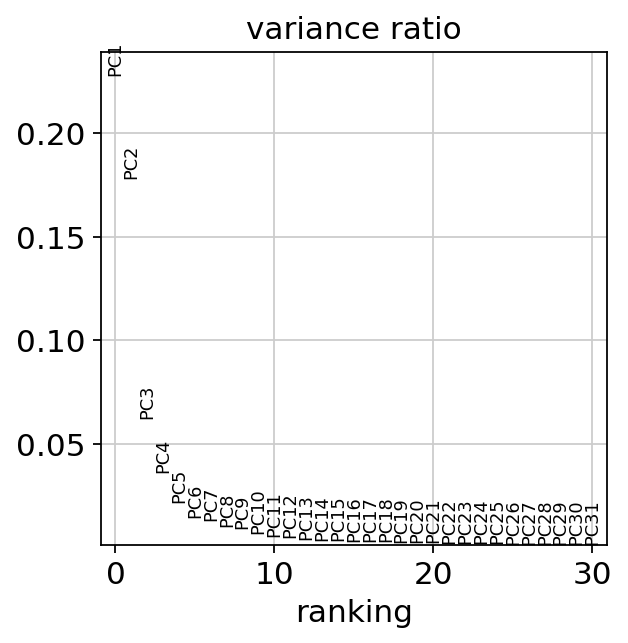

In [5]:
a_tmp = adata.copy()
sc.tl.pca(a_tmp)
sc.pl.pca_variance_ratio(a_tmp)

In [6]:
sc.tl.pca(adata,n_comps=20)
sc.pp.neighbors(adata)
sc.tl.umap(adata)

computing PCA
    on highly variable genes
    with n_comps=20


/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:08)


<AxesSubplot:title={'center':'celltype'}, xlabel='UMAP1', ylabel='UMAP2'>

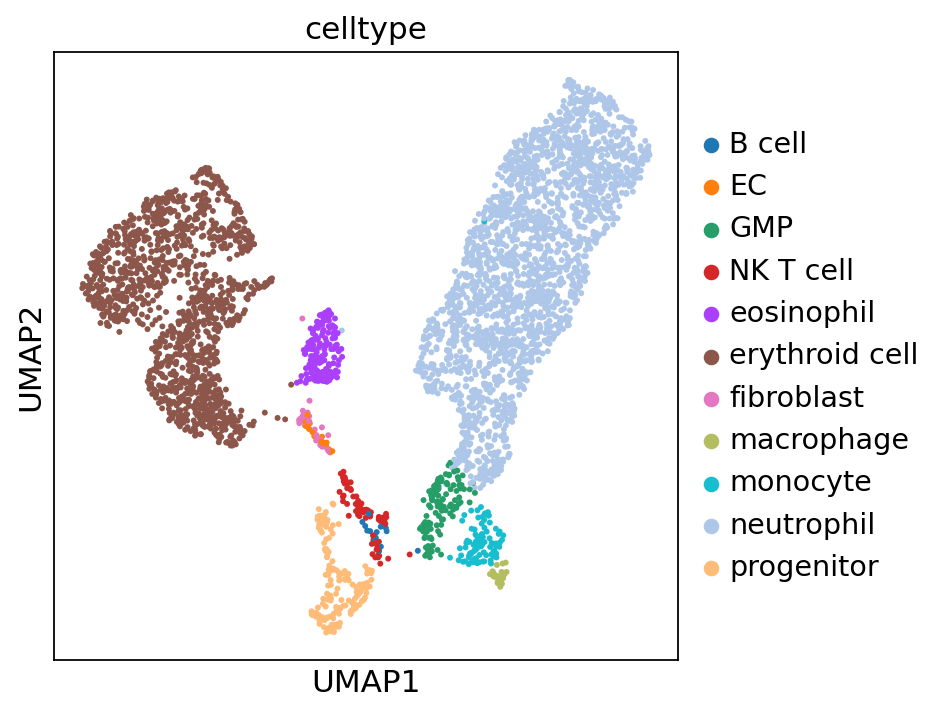

In [10]:
plt.figure(figsize=(5,5))
sc.pl.umap(adata,color="celltype",ax=plt.gca(),show=False)

In [44]:
marker_genes = {  
    'progenitor'     : ["STMN1","LMNB1","NUCKS1","DEK"],
    'GMP'            : ["CTSG","MPO","PRTN3",],
    'neutrophil'     : ["S100A9","S100A8","RETN","LTF","CXCR2"],
    'eosinophil'     : ["FCAR","PTEN","ACSL1"],
    'monocyte'       : ["CCR2","LYZ","VCAN","CD14"], #,"KLF4"
    'macrophage'     : ["CD163","C1QB","C1QA"],
    'B cell'         : ["CD79A","IGKC","IGHM","MS4A1","JCHAIN"],
    'NK T cell'      : ["CCL5","CD3E","CD3D","GZMA","NKG7","GNLY","TRBC2"],#,"CD4","CD8A"], # "CD3E", "CD3G",
    'erythroid cell' : ["HMBS","PRDX2","DENND4A","HBM","SLC4A1","SLC25A37"],
    'fibroblast'     : ["COL1A1","COL1A2","DCN"],#,"FAP"],
    'EC'             : ["PTPRB","EGFL7","PECAM1","CLDN5"],
}

ct_color = {
    'progenitor'      : '#ff9896',
    'GMP'             : '#B34C4A',
    'neutrophil'      : '#279e68',
    'eosinophil'      : 'lightblue',        
    'monocyte'        : '#98df8a',
    'macrophage'      : '#9E72FF',
    'B cell'          : '#1f77b4',
    'NK T cell'       : '#FFBB78',
    'erythroid cell'  : '#8c564b',
    'fibroblast'      : '#e86711',
    'EC'              : '#10E88E',
}

adata.obs["celltype"] = adata.obs["celltype"].astype("category").cat.reorder_categories([ct for ct in marker_genes])
adata.uns["celltype_colors"] = [ct_color[ct] for ct in adata.obs["celltype"].cat.categories]

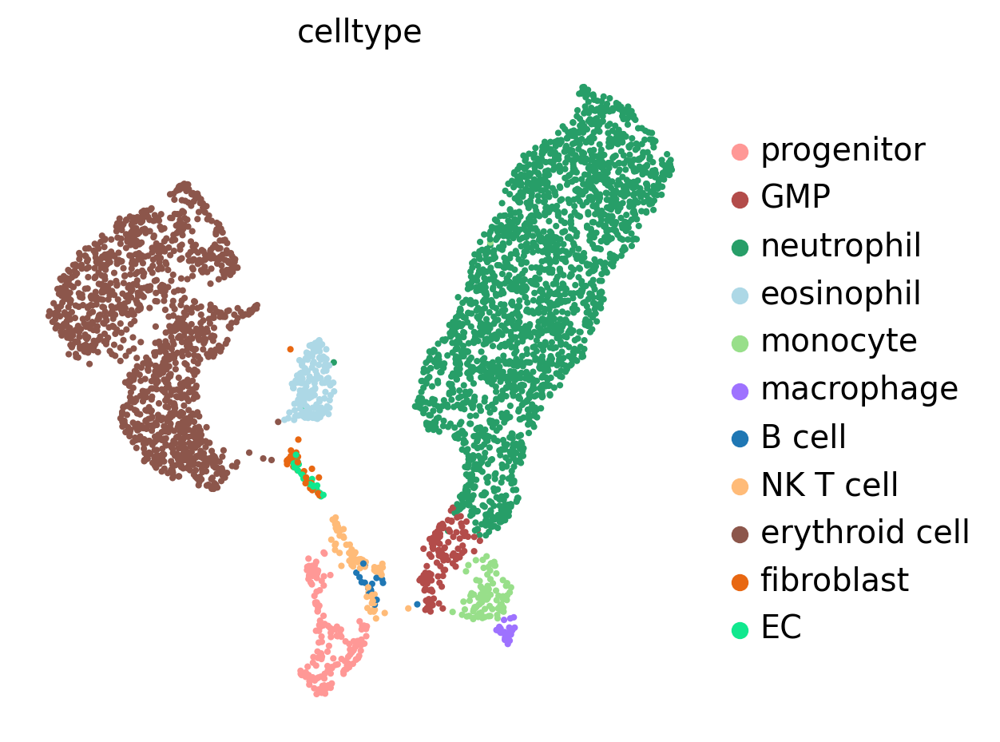

In [51]:
plt.figure(figsize=(5,5))
sc.pl.umap(adata,color="celltype",ax=plt.gca(),show=False,frameon=False)
plt.gcf().savefig("./figures/human_sc_umap.png", bbox_inches = "tight", transparent=True)

/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


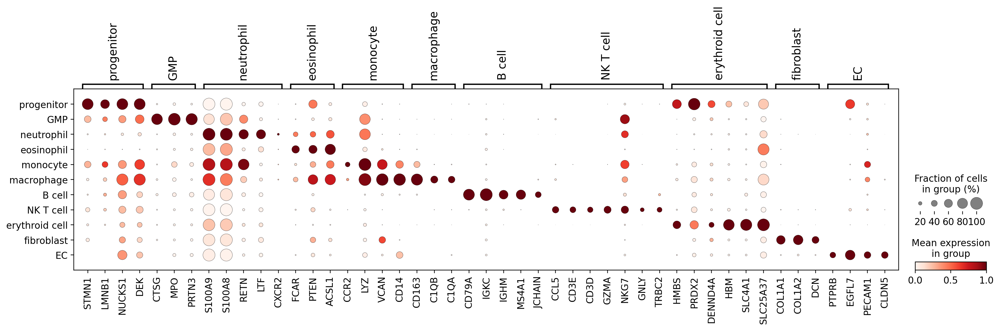

In [53]:
dp = sc.pl.dotplot(adata,marker_genes,"celltype",standard_scale="var",show=False)
plt.gcf().savefig("./figures/human_sc_dotplot_ct_marker.png", bbox_inches = "tight", transparent=True)

#### Proteomics genes

In [59]:
df = pd.read_excel(Path(RESULTS_DIR,'230219_proteomics_gene_lists','gene_enrichment_unique_skull_vertebra_pelvis.xlsx'), index_col=0)  
genes = []
for gene_list in df.loc[df["name"].apply(lambda n: "synap" in n),"intersections"]:
    genes += eval(gene_list)
genes = np.unique(genes)
genes = [g for g in genes if g in adata.var_names]

In [61]:
genes = ["SYNC","PTPRD","CADM1","CHRDL1","SYNPO","PLCXD3"]

/opt/python/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


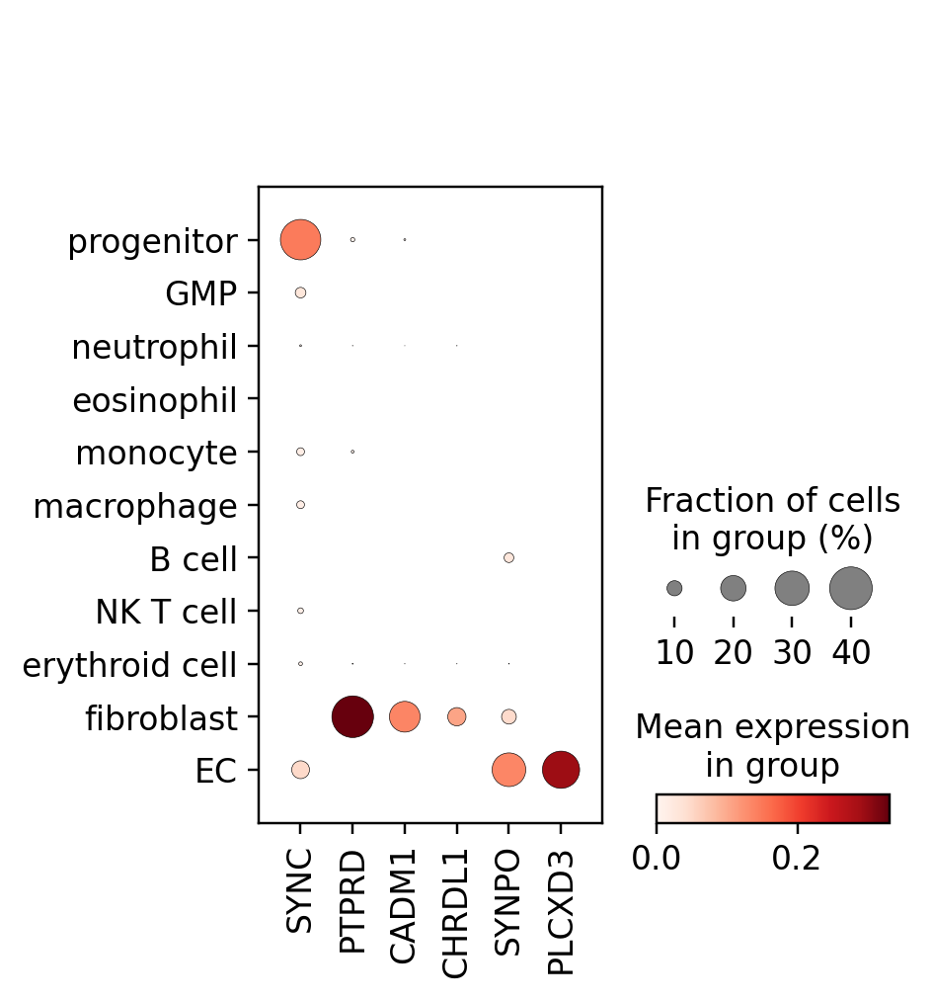

In [63]:
dp = sc.pl.dotplot(adata,genes,"celltype",show=False) #,standard_scale="var"
plt.gcf().savefig("./figures/human_sc_dotplot_neuro_peptides.png", bbox_inches = "tight", transparent=True)

#### ct proportions

In [67]:
display(adata.obs["celltype"].value_counts())
display(adata.obs["celltype"].value_counts(normalize=True))

neutrophil        2192
erythroid cell    1292
eosinophil         169
progenitor         164
GMP                128
monocyte            96
NK T cell           74
fibroblast          31
macrophage          24
EC                  24
B cell              18
Name: celltype, dtype: int64

neutrophil        0.520418
erythroid cell    0.306743
eosinophil        0.040123
progenitor        0.038936
GMP               0.030389
monocyte          0.022792
NK T cell         0.017569
fibroblast        0.007360
macrophage        0.005698
EC                0.005698
B cell            0.004274
Name: celltype, dtype: float64

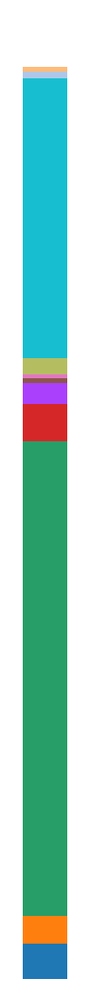

In [82]:
plt.figure(figsize=(0.3,6))
height = 0
ratio = adata.obs["celltype"].value_counts(normalize=True)
count=0
for ct,color in zip(adata.obs["celltype"].cat.categories,adata.uns["celltype_colors"]):
    #delta = 
    #print(height, "-", height+ratio.loc[ct])    
    plt.bar([0],[ratio.loc[ct]],bottom=height)
    height += ratio.loc[ct]
    count += 1

#plt.xlim([0,1])
plt.axis('off')
plt.show()

### Check proteomics genes

In [8]:
df = pd.read_excel(Path(RESULTS_DIR,'230219_proteomics_gene_lists','gene_enrichment_unique_skull_vertebra_pelvis.xlsx'), index_col=0)  

In [9]:
genes = []
for gene_list in df.loc[df["name"].apply(lambda n: "synap" in n),"intersections"]:
    genes += eval(gene_list)
genes = np.unique(genes)
genes = [g for g in genes if g in adata.var_names]

In [11]:
import matplotlib.pyplot as plt

In [15]:
adata

AnnData object with n_obs × n_vars = 4527 × 21031
    obs: 'region', 'organism', 'sample', 'condition', 'n_counts', 'log_counts', 'n_genes', 'mt_fraction', 'size_factors', 'leiden', 'leiden_high_res', 'celltype_1'
    var: 'ensemble_id', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'celltype_1_colors', 'hvg', 'leiden', 'leiden_colors', 'leiden_high_res_colors', 'neighbors', 'pca', 'sample_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

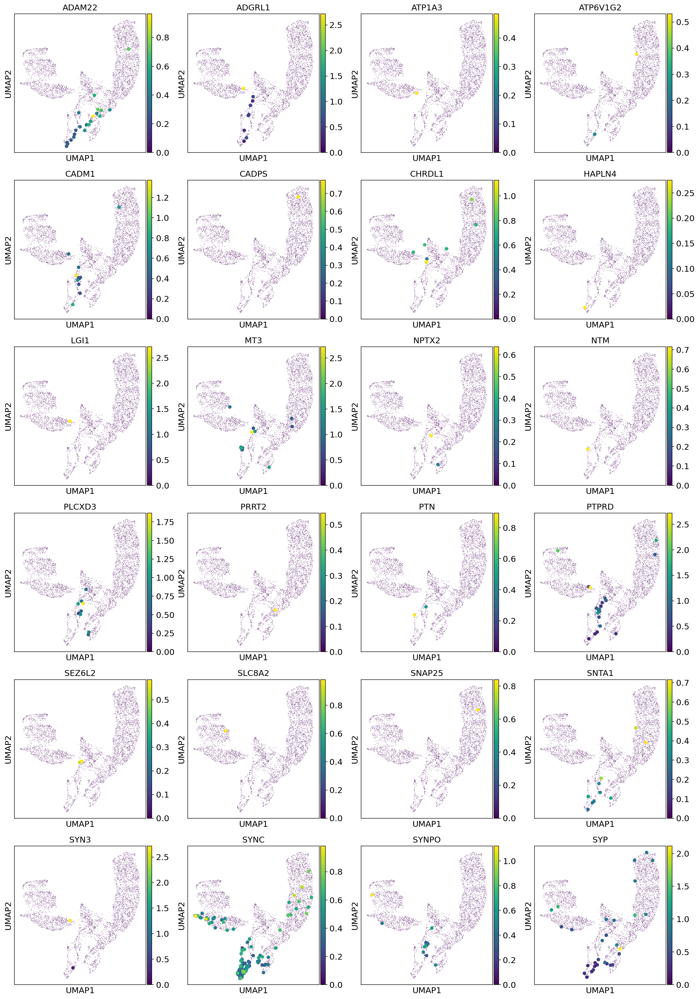

In [19]:
nplots = len(genes)
ncols = 4
nrows = nplots // ncols + bool(nplots % ncols)

fig, axs = plt.subplots(nrows,ncols,figsize=(5*ncols,5*nrows))

axs = axs.flatten()

for i, g in enumerate(genes):
    
    size = [140 if pos else 2 for pos in (adata[:,g].X.copy()[:,0] > 0)]
    sc.pl.umap(adata,color=g,show=False,ax=axs[i],s=size)
    
plt.show()

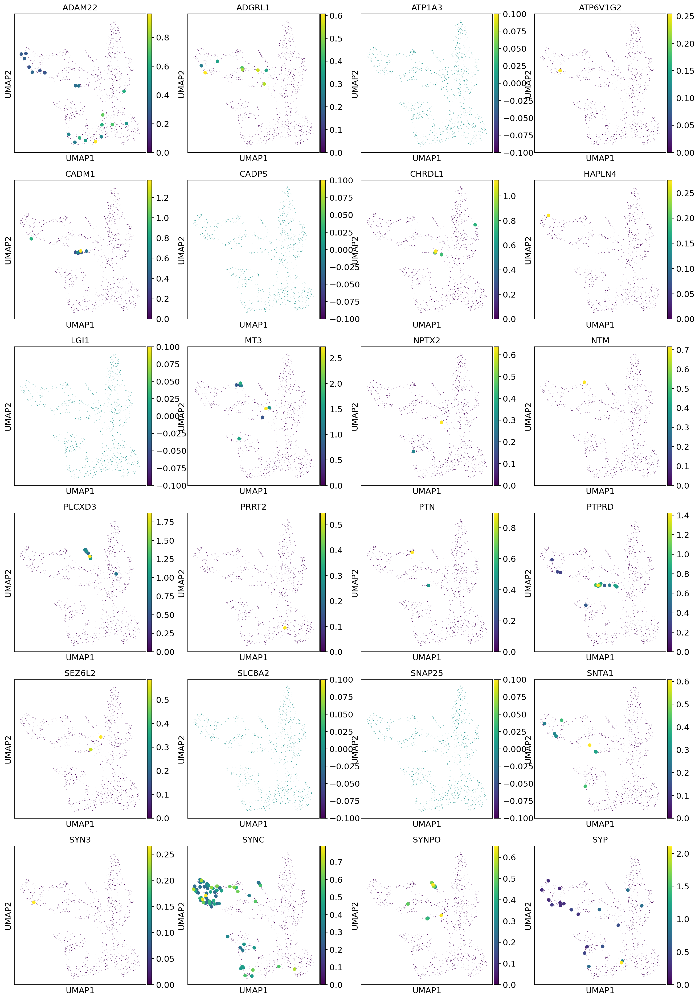

In [18]:
nplots = len(genes)
ncols = 4
nrows = nplots // ncols + bool(nplots % ncols)

fig, axs = plt.subplots(nrows,ncols,figsize=(5*ncols,5*nrows))

axs = axs.flatten()

for i, g in enumerate(genes):
    
    size = [140 if pos else 2 for pos in (adata2[:,g].X.copy()[:,0] > 0)]
    sc.pl.umap(adata2,color=g,show=False,ax=axs[i],s=size)
    
plt.show()

# Final adata and dotplots (without eosinophil cluster)

In [3]:
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors

plt.rcParams['figure.dpi'] = 110
plt.rcParams['savefig.dpi'] = 250
SMALL_SIZE = 13
MEDIUM_SIZE = 15
BIGGER_SIZE = 17
plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title


In [4]:
adata = sc.read(Path(DATA_DIR,"human_sc",f"adata_{DATA_VERSION}_leiden.h5ad"))
adata2 = sc.read(Path(DATA_DIR,"human_sc",f"adata_{DATA_VERSION}_leiden_subset.h5ad"))
adata3 = sc.read(Path(DATA_DIR,"human_sc",f"adata_{DATA_VERSION}_leiden_subset_subset.h5ad"))

####################
# final cell types #
####################
# get coarse annotations
adata.obs["celltype"] = adata.obs["celltype_1"].astype(str)
# get fine annotations (wasn't saved in adata2 h5ad)
ct_to_leiden = {
    "progenitor" : [3,16,17],
    "B T NK DC"  : [13,15],
    "GMP"        : [9,12,22],
    "monocyte"   : [1],
    "macrophage" : [21],
    "neutrophil" : [5,6,8,10],
    #"eosinophil" : [2,4],
    "fibroblast" : [19],
    "EC"         : [20],
    "filter_out" : [2,4,7,14,0,11,18, 23],
}
leiden_to_ct = {str(l):ct for ct,ls in ct_to_leiden.items() for l in ls}
adata2.obs["celltype_2"] = adata2.obs["leiden"].apply(lambda l:leiden_to_ct[l])
adata.obs.loc[adata2.obs_names,"celltype"] = adata2.obs.loc[adata2.obs_names,"celltype_2"]
# get fine annotations for B and NK T cells
adata.obs.loc[adata3.obs_names,"celltype"] = adata3.obs.loc[adata3.obs_names,"celltype_3"]

adata = adata[adata.obs["celltype"] != "filter_out"]

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:03)


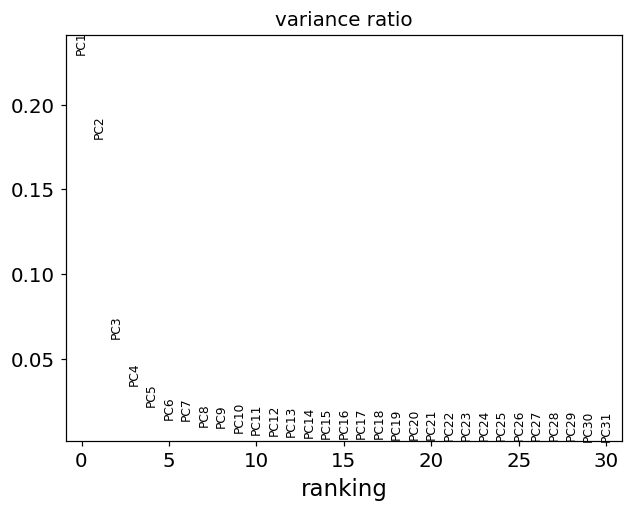

In [5]:
a_tmp = adata.copy()
sc.tl.pca(a_tmp)
sc.pl.pca_variance_ratio(a_tmp)

In [8]:
sc.tl.pca(adata,n_comps=20)
sc.pp.neighbors(adata)
sc.tl.umap(adata)

computing PCA
    on highly variable genes
    with n_comps=20
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:05)


<AxesSubplot:title={'center':'celltype'}, xlabel='UMAP1', ylabel='UMAP2'>

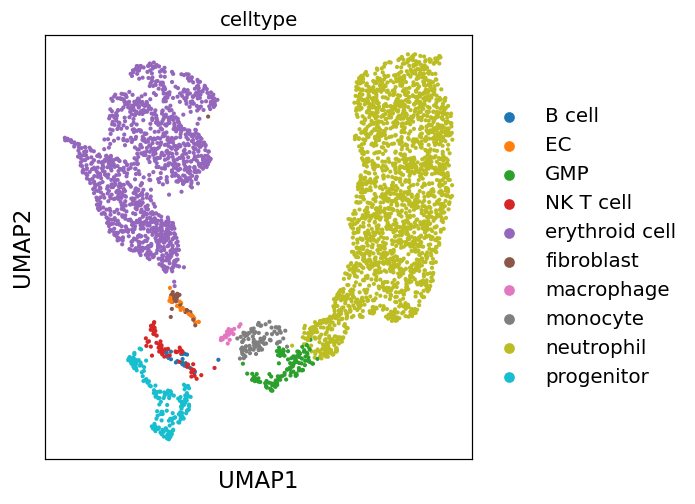

In [9]:
plt.figure(figsize=(5,5))
sc.pl.umap(adata,color="celltype",ax=plt.gca(),show=False)

In [10]:
marker_genes = {  
    'progenitor'     : ["STMN1","LMNB1","NUCKS1","DEK"],
    'GMP'            : ["CTSG","MPO","PRTN3",],
    'neutrophil'     : ["S100A9","S100A8","RETN","LTF","CXCR2"],
    #'eosinophil'     : ["FCAR","PTEN","ACSL1"],
    'monocyte'       : ["CCR2","LYZ","VCAN","CD14"], #,"KLF4"
    'macrophage'     : ["CD163","C1QB","C1QA"],
    'B cell'         : ["CD79A","IGKC","IGHM","MS4A1","JCHAIN"],
    'NK T cell'      : ["CCL5","CD3E","CD3D","GZMA","NKG7","GNLY","TRBC2"],#,"CD4","CD8A"], # "CD3E", "CD3G",
    'erythroid cell' : ["HMBS","PRDX2","DENND4A","HBM","SLC4A1","SLC25A37"],
    'fibroblast'     : ["COL1A1","COL1A2","DCN"],#,"FAP"],
    'EC'             : ["PTPRB","EGFL7","PECAM1","CLDN5"],
}

ct_color = {
    'progenitor'      : '#ff9896',
    'GMP'             : '#B34C4A',
    'neutrophil'      : '#279e68',
    #'eosinophil'      : 'lightblue',        
    'monocyte'        : '#98df8a',
    'macrophage'      : '#9E72FF',
    'B cell'          : '#1f77b4',
    'NK T cell'       : '#FFBB78',
    'erythroid cell'  : '#8c564b',
    'fibroblast'      : '#e86711',
    'EC'              : '#10E88E',
}

adata.obs["celltype"] = adata.obs["celltype"].astype("category").cat.reorder_categories([ct for ct in marker_genes])
adata.uns["celltype_colors"] = [ct_color[ct] for ct in adata.obs["celltype"].cat.categories]

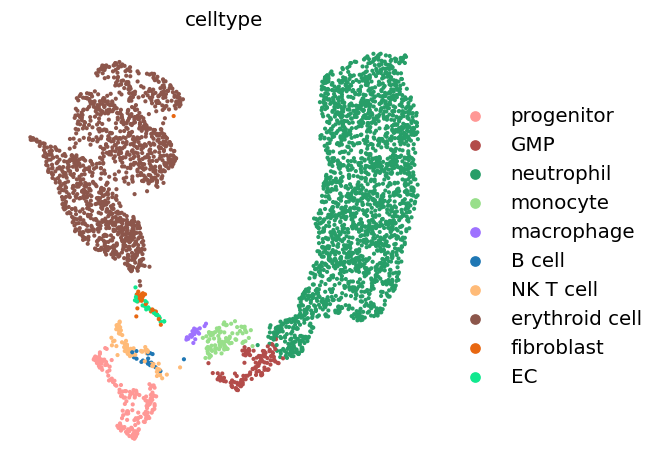

In [11]:
plt.figure(figsize=(5,5))
sc.pl.umap(adata,color="celltype",ax=plt.gca(),show=False,frameon=False)
plt.gcf().savefig("../figures/human_sc_umap.png", bbox_inches = "tight", transparent=True)

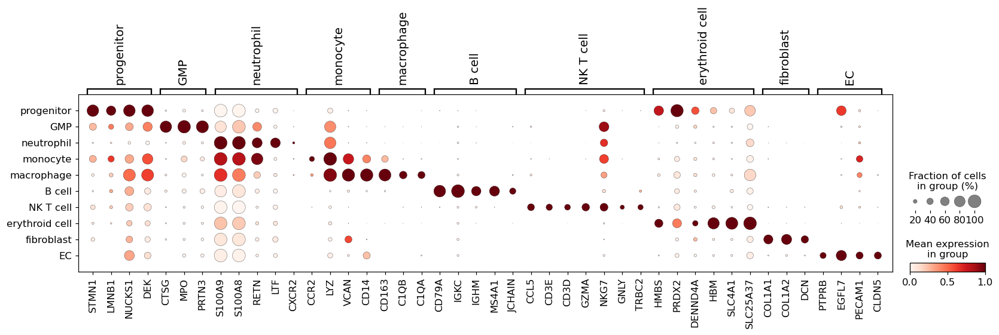

In [12]:
dp = sc.pl.dotplot(adata,marker_genes,"celltype",standard_scale="var",show=False)
plt.gcf().savefig("../figures/human_sc_dotplot_ct_marker.png", bbox_inches = "tight", transparent=True)

#### Proteomics genes

In [ ]:
df = pd.read_excel(Path(RESULTS_DIR,'230219_proteomics_gene_lists','gene_enrichment_unique_skull_vertebra_pelvis.xlsx'), index_col=0)  
genes = []
for gene_list in df.loc[df["name"].apply(lambda n: "synap" in n),"intersections"]:
    genes += eval(gene_list)
genes = np.unique(genes)
genes = [g for g in genes if g in adata.var_names]

In [13]:
genes = ["SYNC","PTPRD","CADM1","CHRDL1","SYNPO","PLCXD3"]

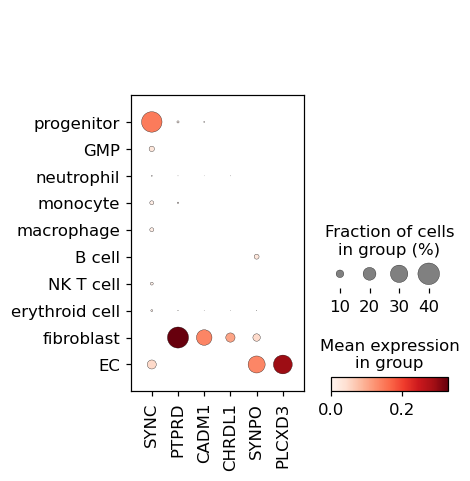

In [14]:
dp = sc.pl.dotplot(adata,genes,"celltype",show=False) #,standard_scale="var"
plt.gcf().savefig("../figures/human_sc_dotplot_neuro_peptides.png", bbox_inches = "tight", transparent=True)

In [16]:
adata.write(Path(DATA_DIR,"human_sc",f"adata_{DATA_VERSION}_human_sc.h5ad"))